In [1]:
from mpl_toolkits.mplot3d import Axes3D 
from statsmodels.iolib.summary2 import summary_col
import matplotlib.pyplot as plt
from sklearn import cluster, datasets, mixture
import numpy as np
from matplotlib.patches import Ellipse
from scipy.stats import multivariate_normal
from sklearn.datasets import make_spd_matrix
from sklearn.datasets import make_sparse_spd_matrix
plt.rcParams["axes.grid"] = False
import matplotlib.image as mpimg
import os
np.random.seed(1)
import scipy

C:\Users\dorli\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Number of gaussians & Number of clusters

In [2]:
def crate_init(k, X_data, dim):
    weights = np.ones((k)) / k
    means_idx = np.random.randint(X_data.shape[0], size=k)
    means = X_data[means_idx]
    covs = np.zeros((k,dim,dim))
    for i in range(0,k):
        covs[i] = make_spd_matrix(dim)
    return weights, means, covs

In [3]:
def E_Step(k, X_data, means, log_covs):
    likelihood = []
    for j in range(0, k):
        co = np.exp(log_covs[j])
        co[co!=co] = 0
        co = co + np.identity(X_data.shape[1])*eps
        likelihood.append(multivariate_normal.pdf(x=X_data, mean=means[j], cov=co))
    likelihood = np.array(likelihood)
    return likelihood

In [4]:
def M_step(k, X_data, weights, means, log_covs, likelihood, eps):
    b = []
    weights_new = np.zeros(weights.shape)
    means_new = np.zeros(means.shape)
    log_covs_new = np.zeros(log_covs.shape)
    for j in range(k):
        b.append((likelihood[j] * weights[j]) / (np.sum([likelihood[i] * weights[i] for i in range(k)], axis=0)+eps))
        means_new[j] = np.sum(b[j].reshape(len(X_data),1) * X_data, axis=0) / (np.sum(b[j]+eps))
        log_covs_new[j] = np.log(np.dot((b[j].reshape(len(X_data),1) * (X_data - means[j])).T, (X_data - means[j])) / (np.sum(b[j])))
        log_covs_new[j] = log_covs_new[j] + np.identity(X_data.shape[1])*eps
        weights_new[j] = np.mean(b[j])
    
    return weights_new / weights_new.sum(), means_new, log_covs_new

In [258]:
def plot_it(k, X_data, means, log_covs, step, folder_name):
    colors = ['tab:blue', 'tab:orange', 'tab:green', 'magenta', 'yellow', 'red', 'brown', 'grey']
    plt.figure(figsize=(12,int(8)))
    plt.title("Iteration {}".format(step))
    axes = plt.gca()
    
    likelihood = []
    for j in range(k):
        co = np.exp(log_covs[j])
        co[co!=co] = 0
        co = co + np.identity(X_data.shape[1])*eps
        
        likelihood.append(multivariate_normal.pdf(x=X_data, mean=means[j], cov=co))
        
        plt.scatter(means[j][0], means[j][1], color=colors[j])
        lambda_, v = np.linalg.eig(co)
        lambda_ = np.sqrt(lambda_)
        ell = Ellipse(xy=(means[j][0], means[j][1]),width=lambda_[0]*2, height=lambda_[1]*2,
        angle=np.rad2deg(np.arccos(v[0, 0])), fill=False, color = colors[j], alpha = 0.4)
        plt.gca().add_artist(ell)
        
        
    likelihood = np.array(likelihood)
    predictions = np.argmax(likelihood, axis=0)
    
    for c in range(k):
        pred_ids = np.where(predictions == c)
        plt.scatter(X_data[pred_ids[0],0], X_data[pred_ids[0],1], color=colors[c], alpha=0.6, edgecolor='none', marker='o')
    
    #plt.scatter(X_data[:,0], X_data[:,1], facecolors='none', edgecolors='grey', marker='o')
        
    
    plt.savefig(folder_name + "img_{0:02d}".format(step), bbox_inches='tight')

In [6]:
def plot_all(num_of_steps, folder_name):
    H, W = 4 , round(num_of_steps/4)
    fig, ax = plt.subplots(W,H, figsize=(60, 100))
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.001, hspace=0.000000001)
    arr = os.listdir(folder_name)
    idx = 0
    for i in range(0,W):
        for j in range(0,H):
            img = mpimg.imread(folder_name + arr[idx])
            ax[i,j].imshow(img)
            idx = idx + 1 

# 2 Dim Gaussians Data 

In [7]:
c_2D = 5
dots_2D = 1000
sprad_2D = 10
eps = 1e-8

In [8]:
labels_2D = np.array(range(0,c_2D))
labels_2D = np.repeat(labels_2D, dots_2D)
mu_x_2D = np.random.random_integers(-sprad_2D,sprad_2D+1,c_2D)
mu_y_2D = np.random.random_integers(-sprad_2D,sprad_2D+1,c_2D)

C:\Users\dorli\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: DeprecationWarning: This function is deprecated. Please call randint(-10, 11 + 1) instead
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\dorli\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: DeprecationWarning: This function is deprecated. Please call randint(-10, 11 + 1) instead
  after removing the cwd from sys.path.


In [9]:
mean_2D = np.zeros((c_2D,2))
cov_2D = np.zeros((c_2D,2,2))
for i in range(0,c_2D):
    mean_2D[i,0] = mu_x_2D[i]
    mean_2D[i,1] = mu_y_2D[i]
    cov_2D[i,:,:] = make_sparse_spd_matrix(2)

In [10]:
X_data_2D = np.zeros((c_2D*dots_2D,2))
for i in range(0,c_2D):
    X_data_2D[i*dots_2D:(i+1)*dots_2D,:] = np.random.multivariate_normal(mean_2D[i], cov_2D[i], dots_2D)

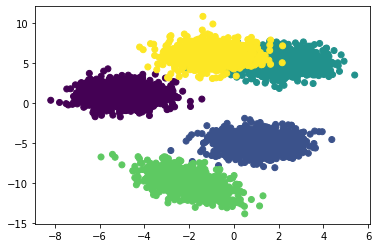

In [11]:
fig = plt.figure()
ax = fig.add_subplot(111)
# plot x,y data with c as the color vector, set the line width of the markers to 0
ax.scatter(X_data_2D[:,0], X_data_2D[:,1], c = labels_2D)

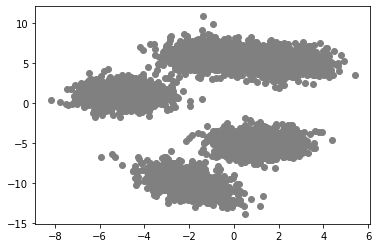

In [12]:
fig = plt.figure()
ax = fig.add_subplot(111)
# plot x,y data with c as the color vector, set the line width of the markers to 0
ax.scatter(X_data_2D[:,0], X_data_2D[:,1], color ='grey')

In [13]:
np.random.shuffle(X_data_2D)

We are implementing MLE model over data samples from uniform distribution.
To initialize the model we are randomly choose covariance matrix and mean and initialize the weights equally.

Define number of clusters to learn, Initialize with equal weights, Random data points as mean, and Positive semidefinite convariance matrix

In [292]:
k_2D = 3
num_of_steps = 100
folder_name_2D = './2D_k_4/'

[[5.37479643 5.03100038]
 [5.30881378 3.38162035]
 [5.13681972 3.47764261]]
[5.37479643 5.03100038]


C:\Users\dorli\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in log
  if __name__ == '__main__':
C:\Users\dorli\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


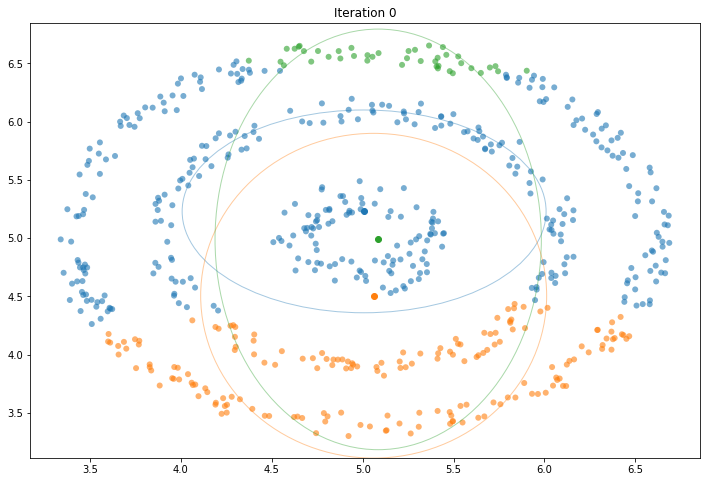

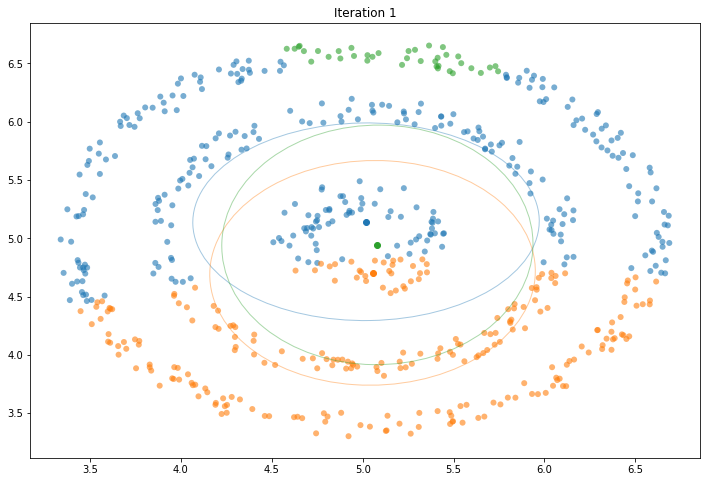

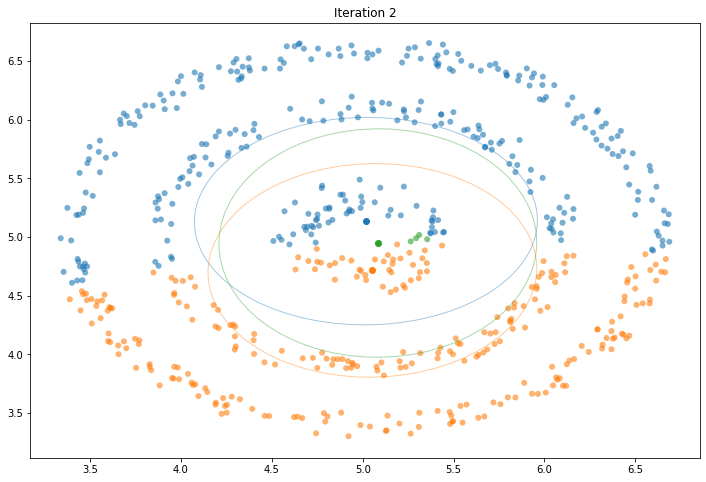

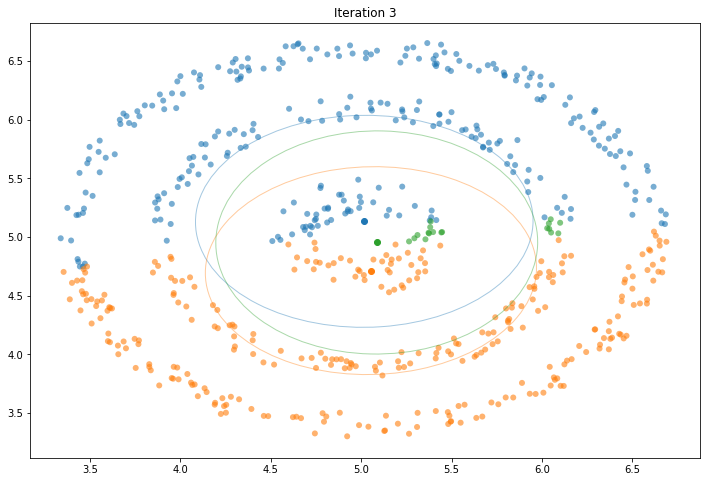

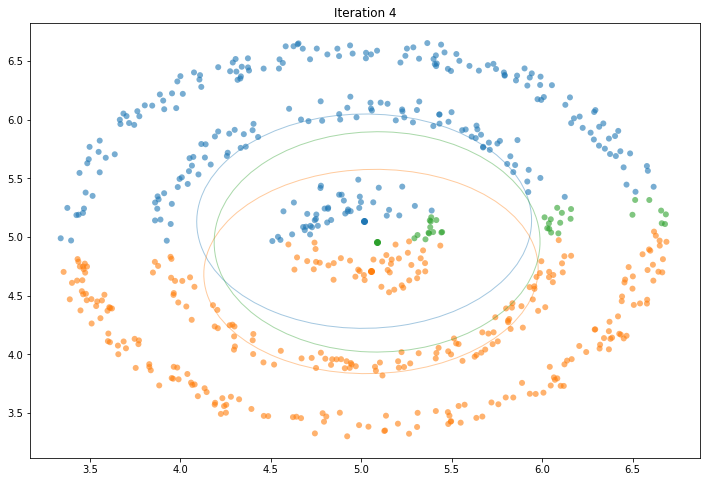

...

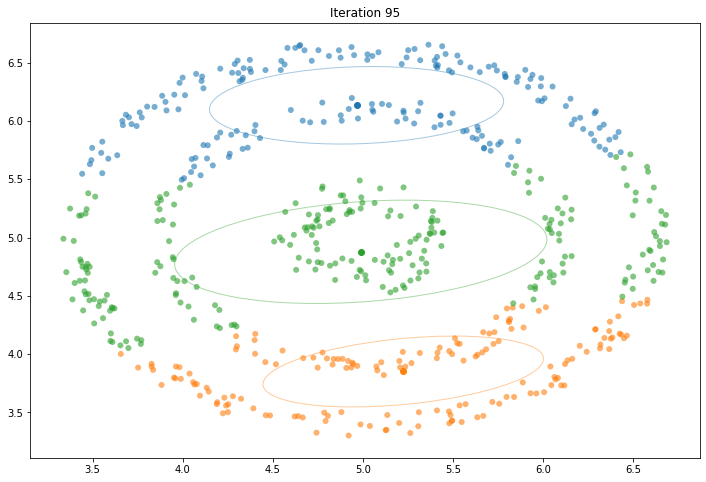

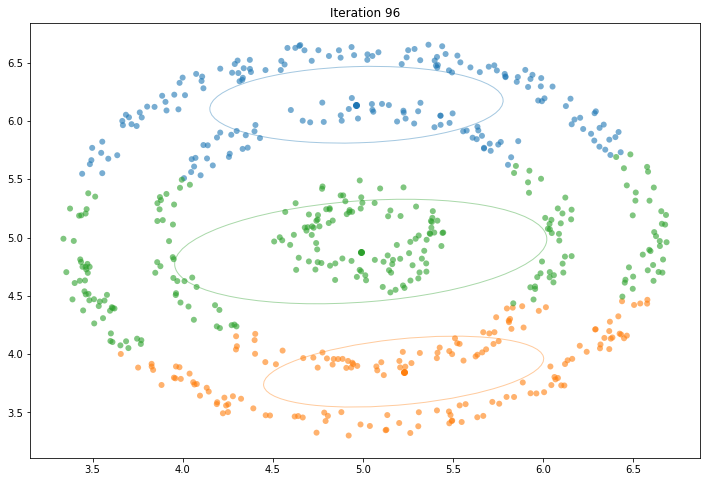

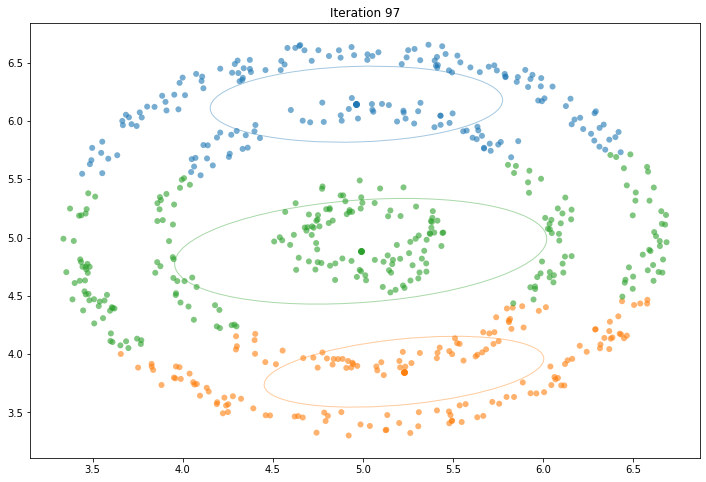

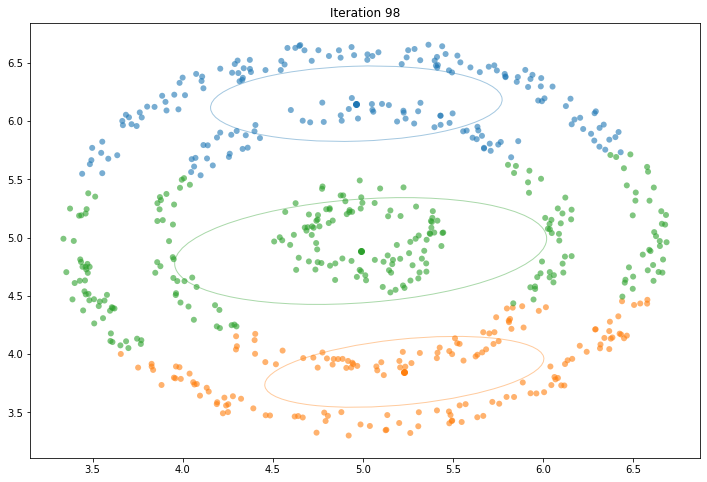

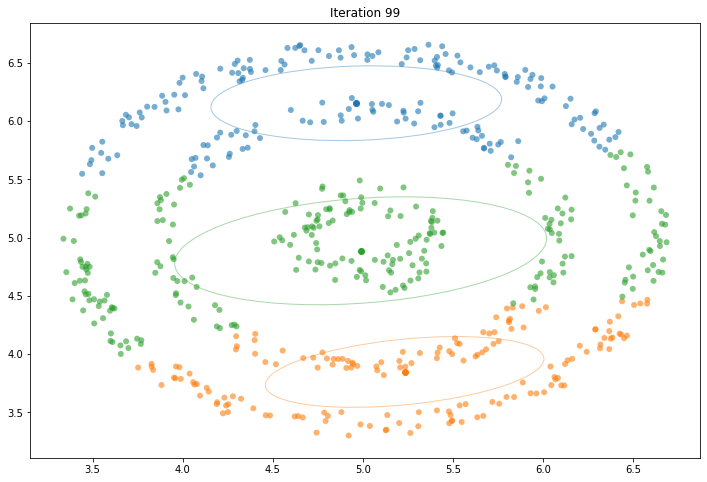

In [293]:
X_data_2D = circles


weights_2D, means_2D, log_covs_2D = crate_init(k_2D, X_data_2D, dim = 2)

for step in range(0,num_of_steps):
    # return what are the odds for data point i will be in gaussian j
    likelihood = E_Step(k_2D, X_data_2D, means_2D, log_covs_2D)
    # fit new weights means and covariances to the likelihood 
    weights_2D, means_2D, log_covs_2D = M_step(k_2D, X_data_2D, weights_2D, means_2D, log_covs_2D, likelihood, eps)
    # plot the new predictions 
    plot_it(k_2D, X_data_2D, means_2D, log_covs_2D ,step, folder_name_2D)

In [16]:
#plot_all(num_of_steps, folder_name_2D)

# 3 Dim Gaussians Data 

In [145]:
c_3D = 3
dots_3D = 100
sprad_3D = 50

In [146]:
labels_3D = np.array(range(0, c_3D))
labels_3D = np.repeat(labels_3D, dots_3D)
mu_x_3D = np.random.random_integers(0, sprad_3D + 1, c_3D)
mu_y_3D = np.random.random_integers(0, sprad_3D + 1, c_3D)
mu_z_3D = np.random.random_integers(0, sprad_3D + 1, c_3D)

C:\Users\dorli\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: DeprecationWarning: This function is deprecated. Please call randint(0, 51 + 1) instead
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\dorli\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: DeprecationWarning: This function is deprecated. Please call randint(0, 51 + 1) instead
  after removing the cwd from sys.path.
C:\Users\dorli\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DeprecationWarning: This function is deprecated. Please call randint(0, 51 + 1) instead
  """


In [147]:
mean_3D = np.zeros((c_3D,3))
cov_3D = np.zeros((c_3D,3,3))
for i in range(0,c_3D):
    mean_3D[i,0] = mu_x_3D[i]
    mean_3D[i,1] = mu_y_3D[i]
    mean_3D[i,2] = mu_z_3D[i]
    cov_3D[i,:,:] = make_sparse_spd_matrix(3)

In [148]:
X_data_3D = np.zeros((c_3D*dots_3D,3))
for i in range(0,c_3D):
    X_data_3D[i*dots_3D:(i+1)*dots_3D,:] = np.random.multivariate_normal(mean_3D[i], cov_3D[i], dots_3D)
    
print(X_data_3D.shape)

(300, 3)


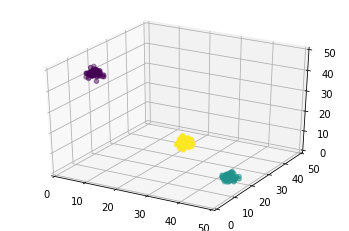

In [149]:
fig = plt.figure()
ax = fig.add_subplot(111, projection= '3d')
# plot x,y data with c as the color vector, set the line width of the markers to 0
ax.scatter(X_data_3D[:,0], X_data_3D[:,1], X_data_3D[:,2], c = labels_3D)
ax.set(xlim=(0, 50), ylim=(0, 50), zlim=(0, 50))
plt.show()

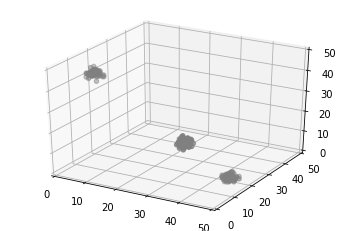

In [150]:
fig = plt.figure()
ax = fig.add_subplot(111, projection= '3d')
# plot x,y data with c as the color vector, set the line width of the markers to 0
ax.scatter(X_data_3D[:,0], X_data_3D[:,1], X_data_3D[:,2], color = 'grey')
ax.set(xlim=(0, 50), ylim=(0, 50), zlim=(0, 50))
plt.show()

We are implementing MLE model over data samples from uniform distribution.
To initialize the model we are randomly choose covariance matrix and mean and initialize the weights equally.

In [166]:
np.random.shuffle(X_data_3D)

In [167]:
X_data_3D.shape

(300, 3)

Define number of clusters to learn, Initialize with equal weights, Random data points as mean, and Positive semidefinite convariance matrix

In [219]:
def plot_it_3D(k, X_data, means, log_covs, step, folder_name):
    colors = ['tab:blue', 'tab:orange', 'tab:green', 'magenta', 'yellow', 'red', 'brown', 'grey']
    fig = plt.figure()
    ax = fig.add_subplot(111, projection= '3d')
    # plot x,y data with c as the color vector, set the line width of the markers to 0
    #ax.scatter(X_data_3D[:,0], X_data_3D[:,1], X_data_3D[:,2], c = labels)
    
    
    plt.title("Iteration {}".format(step+1))
    
    likelihood = []
    for j in range(k):
        co = np.exp(log_covs[j])
        co[co!=co] = 0
        co = co + np.identity(X_data.shape[1])*eps
        likelihood.append(multivariate_normal.pdf(x=X_data, mean=means[j], cov=co))
    likelihood = np.array(likelihood)
    predictions = np.argmax(likelihood, axis=0)


    ax.scatter(X_data_3D[:,0], X_data_3D[:,1], X_data_3D[:,2], c = predictions, marker='o', alpha=0.2)

    #for j in range(k):
    ax.scatter(means[:,0], means[:,1], means[:,2], marker='s', color = 'black', alpha=0.6)
    ax.set(xlim=(2, 5), ylim=(1, 7), zlim=(0, 3))

    plt.savefig(folder_name + "img_{0:02d}".format(step))
    plt.show()

In [220]:
k_3D = 3
num_of_steps = 250 #80
folder_name_3D = './3D_k_4/'

[[2.9 4.2 1.3]
 [3.8 1.9 0.4]
 [2.8 4.8 1.4]]
[2.9 4.2 1.3]


C:\Users\dorli\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in log
  if __name__ == '__main__':


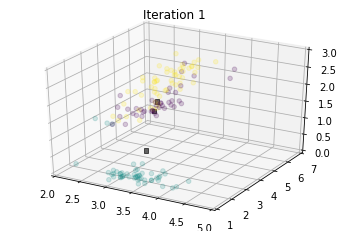

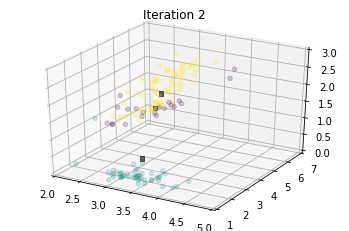

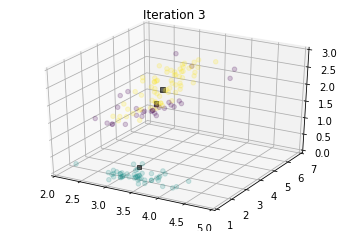

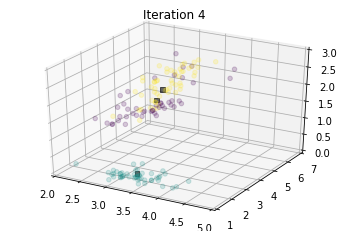

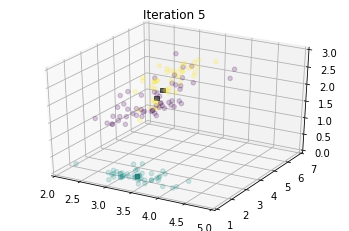

...

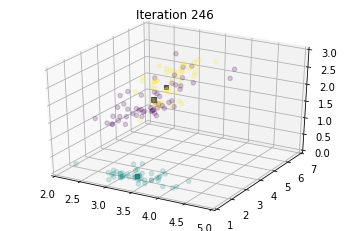

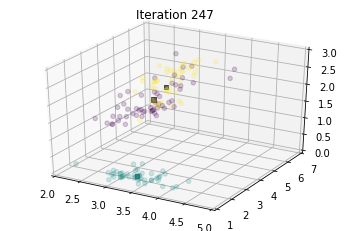

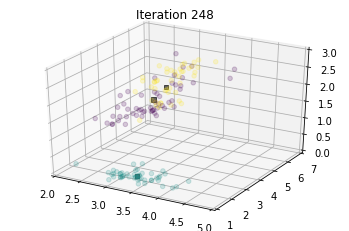

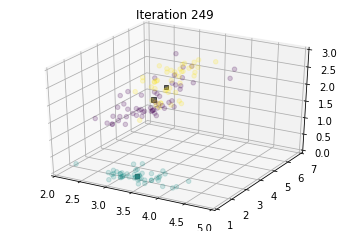

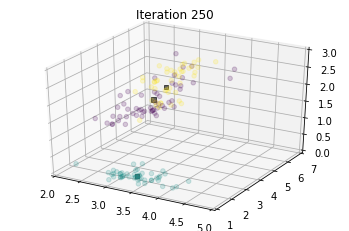

In [221]:
X_data_3D = iris_3

weights_3D, means_3D, covs_3D = crate_init(k_3D, X_data_3D, dim = 3)

for step in range(0,num_of_steps):
    # return what are the odds for data point i will be in gaussian j
    likelihood = E_Step(k_3D, X_data_3D, means_3D, covs_3D)
    # fit new weights means and covariances to the likelihood 
    weights_3D, means_3D, covs_3D = M_step(k_3D, X_data_3D, weights_3D, means_3D, covs_3D, likelihood, eps)
    # plot the new predictions 
    plot_it_3D(k_3D, X_data_3D, means_3D, covs_3D ,step, folder_name_3D)

# IRIS DATASET 

In [177]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn import datasets
from sklearn.decomposition import PCA

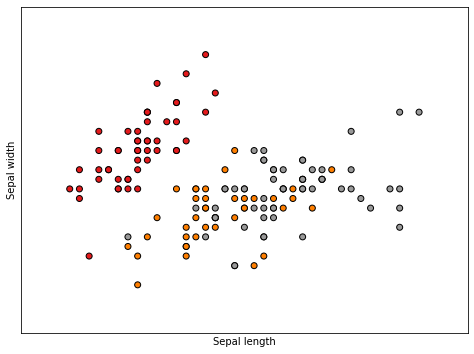

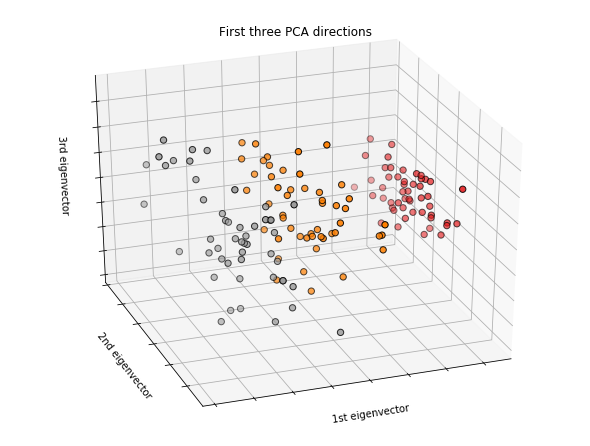

In [178]:
# import some data to play with
iris = datasets.load_iris()
X = iris.data[:, :2]  # we only take the first two features.
y = iris.target

x_min, x_max = X[:, 0].min() - .5, X[:, 0].max() + .5
y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + .5

plt.figure(2, figsize=(8, 6))
plt.clf()

# Plot the training points
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Set1,
            edgecolor='k')
plt.xlabel('Sepal length')
plt.ylabel('Sepal width')

plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())

# To getter a better understanding of interaction of the dimensions
# plot the first three PCA dimensions
fig = plt.figure(1, figsize=(8, 6))
ax = Axes3D(fig, elev=-150, azim=110)
X_reduced = PCA(n_components=3).fit_transform(iris.data)
ax.scatter(X_reduced[:, 0], X_reduced[:, 1], X_reduced[:, 2], c=y,
           cmap=plt.cm.Set1, edgecolor='k', s=40)
ax.set_title("First three PCA directions")
ax.set_xlabel("1st eigenvector")
ax.w_xaxis.set_ticklabels([])
ax.set_ylabel("2nd eigenvector")
ax.w_yaxis.set_ticklabels([])
ax.set_zlabel("3rd eigenvector")
ax.w_zaxis.set_ticklabels([])

plt.show()

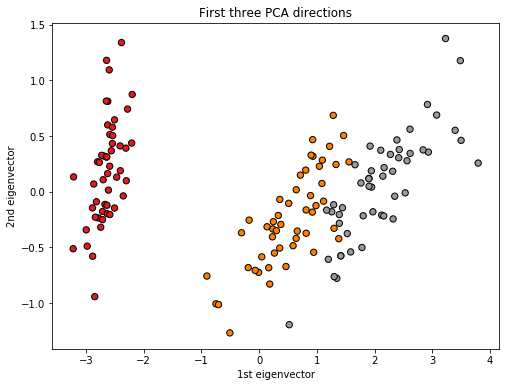

In [179]:
# To getter a better understanding of interaction of the dimensions
# plot the first three PCA dimensions
fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111)
X_reduced = PCA(n_components=2).fit_transform(iris.data)
ax.scatter(X_reduced[:, 0], X_reduced[:, 1], c=y,
           cmap=plt.cm.Set1, edgecolor='k', s=40)
ax.set_title("First three PCA directions")
ax.set_xlabel("1st eigenvector")
ax.set_ylabel("2nd eigenvector")
plt.show()

In [230]:
X_reduced.shape

(150, 2)

iris last 1,2,3 features


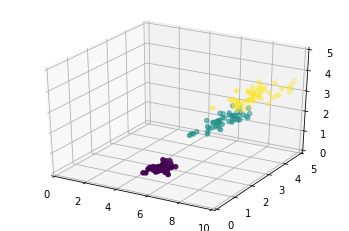

In [255]:
iris = datasets.load_iris()
X = iris.data[:, :2]  # we only take the first two features.
y = iris.target

iris_3 = np.array([iris['data'][:,0], iris['data'][:,2], iris['data'][:,3]]).T

print("iris last 1,2,3 features")
fig = plt.figure()
ax = fig.add_subplot(111, projection= '3d')
# plot x,y data with c as the color vector, set the line width of the markers to 0
ax.scatter(iris_3[:,0], iris_3[:,1], iris_3[:,2], c = y)
ax.set(xlim=(0, 10), ylim=(0, 5), zlim=(0, 5))
plt.show()

iris last 2,3 features


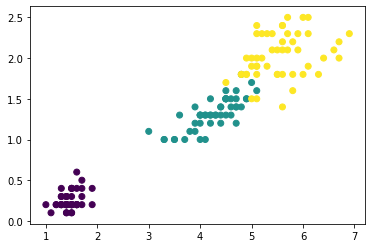

In [181]:
print("iris last 2,3 features")
fig = plt.figure()
ax = fig.add_subplot(111)
# plot x,y data with c as the color vector, set the line width of the markers to 0
ax.scatter(iris['data'][:,2], iris['data'][:,3], c = iris.target)

C:\Users\dorli\Anaconda3\lib\site-packages\ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


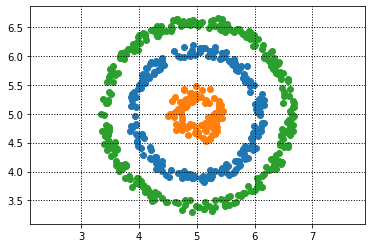

In [262]:
import matplotlib.pyplot as plt
from math import pi, cos, sin
import random

def point(h, k, r_start, r_stop):
    r = random.uniform(r_start, r_stop)
    theta = random.random() * 2 * pi
    return h + cos(theta) * r, k + sin(theta) * r
center_x = 5
center_y = 5
xy = [point(center_x,center_y,1,1.2) for _ in range(200)]
another_circle = [point(center_x,center_y,0.2,0.5) for _ in range(100)]
another_circle2 = [point(center_x,center_y,1.5,1.7) for _ in range(300)]

plt.scatter(*zip(*xy))
plt.scatter(*zip(*another_circle))
plt.scatter(*zip(*another_circle2))
plt.grid(color='k', linestyle=':', linewidth=1)
plt.axes().set_aspect('equal', 'datalim')
plt.show()

cir = np.array(xy)
cir1 = np.array(another_circle)
cir2 = np.array(another_circle2)
circles = np.concatenate((cir1, cir), axis=0)
circles = np.concatenate((circles, cir2), axis=0)

In [291]:
print(circles.shape)

(600, 2)
